<a href="https://colab.research.google.com/github/monrudee-li/monrudee-li/blob/main/Nanotoxicity_metaanalysis_classification_onehotencoder_dropNaNdataset2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This work we want to build the machine learning models to explore the nanotoxicity using the datasets from "Meta-Analysis of Nanoparticle Cytotoxicity via Data-Mining the Literature" published in ACS nano

In [59]:
from sklearn.datasets import load_boston

import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import re
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.linear_model import RidgeCV, LassoCV, Ridge, Lasso
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import (precision_recall_curve,PrecisionRecallDisplay)
from sklearn import metrics
pd.options.display.max_columns = None
pd.options.display.max_rows = None

import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import re
import seaborn as sns


In [60]:
#creating data table
data=pd.read_csv("removedNaN_zetapotential.csv",encoding='cp1252')
data

,Material,Type_Organic_Inorganic,Coat,Diameter,Concentration,Zeta_Potential,Cells,Cell_line_primary cells,Human_Animal_Cells,Animal,Cell morphology,Cell age_embryonic_Adult,Tissue_Source,Exposure_time,Test,Test_Indicator,Biochemical_metric,Cell_viability,Interference checked,Colloidal_stability_checked,Positive_Control
0,SiO2,I,NaN,115.00,2.500000e-06,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,48,Alamar blue,Alamar blue,cell metabolic activity,90.688255,N,Y,N
1,SiO2,I,NaN,115.00,2.500000e-05,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,48,Alamar blue,Alamar blue,cell metabolic activity,101.052635,N,Y,N
2,SiO2,I,NaN,115.00,2.500000e-04,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,48,Alamar blue,Alamar blue,cell metabolic activity,90.688255,N,Y,N
3,SiO2,I,NaN,115.00,2.500000e-03,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,48,Alamar blue,Alamar blue,cell metabolic activity,82.914980,N,Y,N
4,SiO2,I,NaN,115.00,2.500000e-06,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,96,Alamar blue,Alamar blue,cell metabolic activity,104.291500,N,Y,N
5,SiO2,I,NaN,115.00,2.500000e-05,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,96,Alamar blue,Alamar blue,cell metabolic activity,101.700400,N,Y,N
6,SiO2,I,NaN,115.00,2.500000e-04,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,96,Alamar blue,Alamar blue,cell metabolic activity,86.153850,N,Y,N
7,SiO2,I,NaN,115.00,2.500000e-03,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,96,Alamar blue,Alamar blue,cell metabolic activity,75.789474,N,Y,N
8,SiO2,I,NaN,115.00,2.500000e-03,-48.00,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,96,LDH,LDH activity assay kit,LDH leakage,99.825574,N,Y,N
9,ZnO,I,NaN,24.00,2.040000e-05,-44.60,A549,L,H,NaN,Epithelial,A,Lung,48,WST?1,tetrazolium salt,cell metabolic activity,91.115460,N,N,N


In [61]:
data.shape

(1261, 21)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fa700fae910>,
      dtype=object)

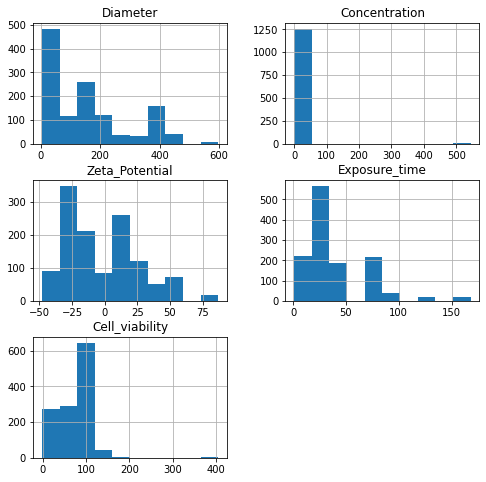

In [62]:
#plot only the numeric data
data.hist(figsize=(8,8))

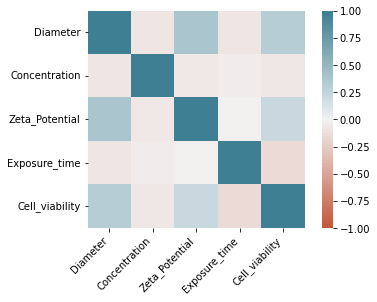

In [63]:
corr_matrix=data.corr()

ax = sns.heatmap(corr_matrix,vmin=-1, vmax=1, center=0,cmap=sns.diverging_palette(20, 220, n=200),square=True)
ax.set_xticklabels(ax.get_xticklabels(),rotation=45, horizontalalignment='right');

#sns.heatmap(corr_matrix,annot=True)

In [64]:
data.isna().sum()

Material                         0
Type_Organic_Inorganic           0
Coat                           721
Diameter                         0
Concentration                    0
Zeta_Potential                   0
Cells                            0
Cell_line_primary cells          0
Human_Animal_Cells               0
Animal                         902
Cell morphology                  0
Cell age_embryonic_Adult         0
Tissue_Source                    0
Exposure_time                    0
Test                             0
Test_Indicator                   0
Biochemical_metric               0
Cell_viability                   0
Interference checked             0
Colloidal_stability_checked      0
Positive_Control                 0
dtype: int64

In [65]:
total_sample = len(data)
dropped_rows = []

In [66]:
#drop NaN values
for i in range(total_sample):
    if np.isnan(data.Zeta_Potential[i]):
        data = data.drop([i])
        dropped_rows.append(str(i))
#Coat is string...cannot use this code to drop it
    #if np.isnan(data.Diameter[i]):
    #    data = data.drop([i])
    #    dropped_rows.append(str(i))
    #elif np.isnan(data.Concentration[i]):
    #    data = data.drop([i])
    #    dropped_rows.append(str(i))
    #elif np.isnan(data.Zeta_Potential[i]):
    #    data = data.drop([i])
    #    dropped_rows.append(str(i))
    #elif np.isnan(data.Exposure_time[i]):
    #    data = data.drop([i])
    #    dropped_rows.append(str(i))
    #elif np.isnan(data.Cell_viability[i]):
    #    data = data.drop([i])
    #    dropped_rows.append(str(i))
        
#data = data.drop(columns = ['Animal'])  #drop column "animal" but still we got Zeta Potential and Coat that still contain NaN
data = data.reset_index()
data = data.drop(columns = ['index'])

data.head()

,Material,Type_Organic_Inorganic,Coat,Diameter,Concentration,Zeta_Potential,Cells,Cell_line_primary cells,Human_Animal_Cells,Animal,Cell morphology,Cell age_embryonic_Adult,Tissue_Source,Exposure_time,Test,Test_Indicator,Biochemical_metric,Cell_viability,Interference checked,Colloidal_stability_checked,Positive_Control
0,SiO2,I,NaN,115.0,0.000003,-48.0,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,48,Alamar blue,Alamar blue,cell metabolic activity,90.688255,N,Y,N
1,SiO2,I,NaN,115.0,0.000025,-48.0,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,48,Alamar blue,Alamar blue,cell metabolic activity,101.052635,N,Y,N
2,SiO2,I,NaN,115.0,0.000250,-48.0,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,48,Alamar blue,Alamar blue,cell metabolic activity,90.688255,N,Y,N
3,SiO2,I,NaN,115.0,0.002500,-48.0,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,48,Alamar blue,Alamar blue,cell metabolic activity,82.914980,N,Y,N
4,SiO2,I,NaN,115.0,0.000003,-48.0,HUVEC,P,H,NaN,Endothelial,E,Umbilical cord,96,Alamar blue,Alamar blue,cell metabolic activity,104.291500,N,Y,N


In [67]:
data.columns

Index(['Material', 'Type_Organic_Inorganic', 'Coat', 'Diameter',
       'Concentration', 'Zeta_Potential', 'Cells', 'Cell_line_primary cells',
       'Human_Animal_Cells', 'Animal', 'Cell morphology',
       'Cell age_embryonic_Adult', 'Tissue_Source', 'Exposure_time', 'Test',
       'Test_Indicator', 'Biochemical_metric', 'Cell_viability',
       'Interference checked', 'Colloidal_stability_checked',
       'Positive_Control'],
      dtype='object')

In [68]:
#Encoding non numeric data using one-hot encoder
en_mat = pd.get_dummies(data['Material'], prefix='Mat')
data = data.drop('Material',axis = 1)
data = data.join(en_mat)

en_coat = pd.get_dummies(data['Coat'], prefix='Coat')
data = data.drop('Coat',axis = 1)
data = data.join(en_coat)

en_ts = pd.get_dummies(data['Tissue_Source'], prefix='TS')
data = data.drop('Tissue_Source',axis = 1)
data = data.join(en_ts)

en_typ = pd.get_dummies(data['Type_Organic_Inorganic'], prefix='Type')
data = data.drop('Type_Organic_Inorganic',axis = 1)
data = data.join(en_typ)

en_cell = pd.get_dummies(data['Cells'], prefix='Cells')
data = data.drop('Cells',axis = 1)
data = data.join(en_cell)

en_cLine = pd.get_dummies(data['Cell_line_primary cells'], prefix='Cell_Line')
data = data.drop('Cell_line_primary cells',axis = 1)
data = data.join(en_cLine)

en_fro = pd.get_dummies(data['Human_Animal_Cells'], prefix='From')
data = data.drop('Human_Animal_Cells',axis = 1)
data = data.join(en_fro)

en_morp = pd.get_dummies(data['Cell morphology'], prefix='Morp')
data = data.drop('Cell morphology',axis = 1)
data = data.join(en_morp)

en_age = pd.get_dummies(data['Cell age_embryonic_Adult'], prefix='Age')
data = data.drop('Cell age_embryonic_Adult',axis = 1)
data = data.join(en_age)

en_test = pd.get_dummies(data['Test'], prefix='Test')
data = data.drop('Test',axis = 1)
data = data.join(en_test)

en_ti = pd.get_dummies(data['Test_Indicator'], prefix='TI')
data = data.drop('Test_Indicator',axis = 1)
data = data.join(en_ti)

en_bm = pd.get_dummies(data['Biochemical_metric'], prefix='BM')
data = data.drop('Biochemical_metric',axis = 1)
data = data.join(en_bm)

en_inf = pd.get_dummies(data['Interference checked'], prefix='Inf')
data = data.drop('Interference checked',axis = 1)
data = data.join(en_inf)

en_cc = pd.get_dummies(data['Colloidal_stability_checked'], prefix='CSC')
data = data.drop('Colloidal_stability_checked',axis = 1)
data = data.join(en_cc)

en_pc = pd.get_dummies(data['Positive_Control'], prefix='PC')
data = data.drop('Positive_Control',axis = 1)
data = data.join(en_pc)

en_an = pd.get_dummies(data['Animal'], prefix='AN')
data = data.drop('Animal',axis = 1)
data = data.join(en_an)

data


,Diameter,Concentration,Zeta_Potential,Exposure_time,Cell_viability,Mat_Ag,Mat_Au,Mat_Chitosan,Mat_CuO,Mat_Dendrimer,Mat_Eudragit RL,Mat_Iron oxide,Mat_Liposomes,Mat_PLGA,Mat_Pt,Mat_QDs,Mat_SLN,Mat_Se,Mat_SiO2,Mat_TiO2,Mat_ZnO,Coat_COOH,Coat_CTAB,Coat_Chitosan,Coat_Digestive enzymes,Coat_Folic acid,Coat_Hyaluronic acid,Coat_Hyaluronic acid,Coat_NH2,Coat_PEG,Coat_PEG to the PEI,Coat_PEI,Coat_PVA,Coat_PVP,Coat_Phosphonate,Coat_Poloxamer 188 (Pluronic F68),Coat_TGA,Coat_TGA-gelatine,Coat_folic acid with intermediate inorganic (silica) coating,Coat_folic acid with intermediate organic (PEG) coating,TS_Adrenal gland,TS_Areolar tissue,TS_Blood,TS_Bone Marrow,TS_Bone marrow,TS_Brain,TS_Breast,TS_Cervix,TS_Colon,TS_Kidney,TS_Lung,TS_Ovary,TS_Prostate,TS_Skin,TS_Umbilical cord,TS_lung,TS_stomach,Type_I,Type_O,Cells_A431,Cells_A549,Cells_AGS,Cells_C17.2,Cells_COS?1,Cells_Caco?2,Cells_Calu?3,Cells_Colo?205,Cells_HDF,Cells_HEp?2,Cells_HUVEC,Cells_HaCaT,Cells_HeLa,Cells_IMR90,Cells_J774,Cells_KEC,Cells_L929,Cells_MCF7,Cells_MDBK,Cells_Monocytes,Cells_NR8383,Cells_PC12,Cells_PC3,Cells_RAW 264.7,Cells_SH?SY5Y,Cells_SKOV?3,Cells_SW480,Cells_THP?1,Cells_hMSCs,Cells_primary alveolar Epithelial cells,Cells_primary alveolar Macrophage,Cells_primary alveolar epithelial cells,Cells_primary tissue Macrophage,Cell_Line_L,Cell_Line_P,From_A,From_H,Morp_Endothelial,Morp_Epithelial,Morp_Fibroblast,Morp_Irregular,Morp_Keratinocyte,Morp_Macrophage,Morp_Mesenchymal,Morp_Monocyte,Morp_Monocyte/Macrophage,Morp_Neuronal,Age_A,Age_E,Test_Alamar Blue,Test_Alamar blue,Test_ApoTox?Glo? Triplex,Test_CellTiter?Blue,Test_CellTiter?Blue,Test_CellTiter?Glo,Test_LDH,Test_Live/Dead,Test_MTS,Test_MTT,Test_NR,Test_Promegas CTB Assay,Test_Vialight,Test_WST?1,Test_XTT,TI_Alamar blue,TI_Annexin V,"TI_Calcein AM, Ethidium homodimer-1","TI_Calcein AM, propidium iodide",TI_Caspase-Glo? 3/7 Reagent,TI_LDH activity assay kit,TI_Propidium iodide,TI_Sytox Red,TI_calcein AM,TI_luciferase,TI_tetrazolium salt,TI_toluylene red,TI_trypan blue,BM_ATP content,BM_LDH leakage,BM_cell membrane integrity,BM_cell metabolic activity,BM_lysosomal uptake,BM_protease activity,Inf_N,Inf_Y,CSC_N,CSC_Y,PC_N,PC_Y,"AN_Cow, Bos taurus",AN_Monkey (Cercopithecus aethiops),AN_Mouse,AN_Rat,AN_rat
0,115.00,2.500000e-06,-48.00,48,90.688255,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0
1,115.00,2.500000e-05,-48.00,48,101.052635,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0
2,115.00,2.500000e-04,-48.00,48,90.688255,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0
3,115.00,2.500000e-03,-48.00,48,82.914980,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0
4,115.00,2.500000e-06,-48.00,96,104.291500,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0
5,115.00,2.500000e-05,-48.00,96,101.700400,0,0,0,0,0

In [69]:
data.shape

(1261, 153)

In [70]:
df = data
cols = list(data.columns.values) #Make a list of all of the columns in the df
cols.pop(cols.index('Cell_viability')) #Remove b from list
df = df[cols+['Cell_viability']]

df

,Diameter,Concentration,Zeta_Potential,Exposure_time,Mat_Ag,Mat_Au,Mat_Chitosan,Mat_CuO,Mat_Dendrimer,Mat_Eudragit RL,Mat_Iron oxide,Mat_Liposomes,Mat_PLGA,Mat_Pt,Mat_QDs,Mat_SLN,Mat_Se,Mat_SiO2,Mat_TiO2,Mat_ZnO,Coat_COOH,Coat_CTAB,Coat_Chitosan,Coat_Digestive enzymes,Coat_Folic acid,Coat_Hyaluronic acid,Coat_Hyaluronic acid,Coat_NH2,Coat_PEG,Coat_PEG to the PEI,Coat_PEI,Coat_PVA,Coat_PVP,Coat_Phosphonate,Coat_Poloxamer 188 (Pluronic F68),Coat_TGA,Coat_TGA-gelatine,Coat_folic acid with intermediate inorganic (silica) coating,Coat_folic acid with intermediate organic (PEG) coating,TS_Adrenal gland,TS_Areolar tissue,TS_Blood,TS_Bone Marrow,TS_Bone marrow,TS_Brain,TS_Breast,TS_Cervix,TS_Colon,TS_Kidney,TS_Lung,TS_Ovary,TS_Prostate,TS_Skin,TS_Umbilical cord,TS_lung,TS_stomach,Type_I,Type_O,Cells_A431,Cells_A549,Cells_AGS,Cells_C17.2,Cells_COS?1,Cells_Caco?2,Cells_Calu?3,Cells_Colo?205,Cells_HDF,Cells_HEp?2,Cells_HUVEC,Cells_HaCaT,Cells_HeLa,Cells_IMR90,Cells_J774,Cells_KEC,Cells_L929,Cells_MCF7,Cells_MDBK,Cells_Monocytes,Cells_NR8383,Cells_PC12,Cells_PC3,Cells_RAW 264.7,Cells_SH?SY5Y,Cells_SKOV?3,Cells_SW480,Cells_THP?1,Cells_hMSCs,Cells_primary alveolar Epithelial cells,Cells_primary alveolar Macrophage,Cells_primary alveolar epithelial cells,Cells_primary tissue Macrophage,Cell_Line_L,Cell_Line_P,From_A,From_H,Morp_Endothelial,Morp_Epithelial,Morp_Fibroblast,Morp_Irregular,Morp_Keratinocyte,Morp_Macrophage,Morp_Mesenchymal,Morp_Monocyte,Morp_Monocyte/Macrophage,Morp_Neuronal,Age_A,Age_E,Test_Alamar Blue,Test_Alamar blue,Test_ApoTox?Glo? Triplex,Test_CellTiter?Blue,Test_CellTiter?Blue,Test_CellTiter?Glo,Test_LDH,Test_Live/Dead,Test_MTS,Test_MTT,Test_NR,Test_Promegas CTB Assay,Test_Vialight,Test_WST?1,Test_XTT,TI_Alamar blue,TI_Annexin V,"TI_Calcein AM, Ethidium homodimer-1","TI_Calcein AM, propidium iodide",TI_Caspase-Glo? 3/7 Reagent,TI_LDH activity assay kit,TI_Propidium iodide,TI_Sytox Red,TI_calcein AM,TI_luciferase,TI_tetrazolium salt,TI_toluylene red,TI_trypan blue,BM_ATP content,BM_LDH leakage,BM_cell membrane integrity,BM_cell metabolic activity,BM_lysosomal uptake,BM_protease activity,Inf_N,Inf_Y,CSC_N,CSC_Y,PC_N,PC_Y,"AN_Cow, Bos taurus",AN_Monkey (Cercopithecus aethiops),AN_Mouse,AN_Rat,AN_rat,Cell_viability
0,115.00,2.500000e-06,-48.00,48,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,90.688255
1,115.00,2.500000e-05,-48.00,48,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,101.052635
2,115.00,2.500000e-04,-48.00,48,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,90.688255
3,115.00,2.500000e-03,-48.00,48,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,82.914980
4,115.00,2.500000e-06,-48.00,96,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,104.291500
5,115.00,2.500000e-05,-48.00,96,0,0,0,0,0,0,0,0,0,0,

In [71]:
#assign high-low to Cell_Viability

df.loc[data['Cell_viability'] < 50, 'Cell_viability'] = 0
df.loc[data['Cell_viability'] >= 50, 'Cell_viability'] = 1

df

,Diameter,Concentration,Zeta_Potential,Exposure_time,Mat_Ag,Mat_Au,Mat_Chitosan,Mat_CuO,Mat_Dendrimer,Mat_Eudragit RL,Mat_Iron oxide,Mat_Liposomes,Mat_PLGA,Mat_Pt,Mat_QDs,Mat_SLN,Mat_Se,Mat_SiO2,Mat_TiO2,Mat_ZnO,Coat_COOH,Coat_CTAB,Coat_Chitosan,Coat_Digestive enzymes,Coat_Folic acid,Coat_Hyaluronic acid,Coat_Hyaluronic acid,Coat_NH2,Coat_PEG,Coat_PEG to the PEI,Coat_PEI,Coat_PVA,Coat_PVP,Coat_Phosphonate,Coat_Poloxamer 188 (Pluronic F68),Coat_TGA,Coat_TGA-gelatine,Coat_folic acid with intermediate inorganic (silica) coating,Coat_folic acid with intermediate organic (PEG) coating,TS_Adrenal gland,TS_Areolar tissue,TS_Blood,TS_Bone Marrow,TS_Bone marrow,TS_Brain,TS_Breast,TS_Cervix,TS_Colon,TS_Kidney,TS_Lung,TS_Ovary,TS_Prostate,TS_Skin,TS_Umbilical cord,TS_lung,TS_stomach,Type_I,Type_O,Cells_A431,Cells_A549,Cells_AGS,Cells_C17.2,Cells_COS?1,Cells_Caco?2,Cells_Calu?3,Cells_Colo?205,Cells_HDF,Cells_HEp?2,Cells_HUVEC,Cells_HaCaT,Cells_HeLa,Cells_IMR90,Cells_J774,Cells_KEC,Cells_L929,Cells_MCF7,Cells_MDBK,Cells_Monocytes,Cells_NR8383,Cells_PC12,Cells_PC3,Cells_RAW 264.7,Cells_SH?SY5Y,Cells_SKOV?3,Cells_SW480,Cells_THP?1,Cells_hMSCs,Cells_primary alveolar Epithelial cells,Cells_primary alveolar Macrophage,Cells_primary alveolar epithelial cells,Cells_primary tissue Macrophage,Cell_Line_L,Cell_Line_P,From_A,From_H,Morp_Endothelial,Morp_Epithelial,Morp_Fibroblast,Morp_Irregular,Morp_Keratinocyte,Morp_Macrophage,Morp_Mesenchymal,Morp_Monocyte,Morp_Monocyte/Macrophage,Morp_Neuronal,Age_A,Age_E,Test_Alamar Blue,Test_Alamar blue,Test_ApoTox?Glo? Triplex,Test_CellTiter?Blue,Test_CellTiter?Blue,Test_CellTiter?Glo,Test_LDH,Test_Live/Dead,Test_MTS,Test_MTT,Test_NR,Test_Promegas CTB Assay,Test_Vialight,Test_WST?1,Test_XTT,TI_Alamar blue,TI_Annexin V,"TI_Calcein AM, Ethidium homodimer-1","TI_Calcein AM, propidium iodide",TI_Caspase-Glo? 3/7 Reagent,TI_LDH activity assay kit,TI_Propidium iodide,TI_Sytox Red,TI_calcein AM,TI_luciferase,TI_tetrazolium salt,TI_toluylene red,TI_trypan blue,BM_ATP content,BM_LDH leakage,BM_cell membrane integrity,BM_cell metabolic activity,BM_lysosomal uptake,BM_protease activity,Inf_N,Inf_Y,CSC_N,CSC_Y,PC_N,PC_Y,"AN_Cow, Bos taurus",AN_Monkey (Cercopithecus aethiops),AN_Mouse,AN_Rat,AN_rat,Cell_viability
0,115.00,2.500000e-06,-48.00,48,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,1.0
1,115.00,2.500000e-05,-48.00,48,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,1.0
2,115.00,2.500000e-04,-48.00,48,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,1.0
3,115.00,2.500000e-03,-48.00,48,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,1.0
4,115.00,2.500000e-06,-48.00,96,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,1.0
5,115.00,2.500000e-05,-48.00,96,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,

In [72]:
df.columns

Index(['Diameter', 'Concentration', 'Zeta_Potential', 'Exposure_time',
       'Mat_Ag', 'Mat_Au', 'Mat_Chitosan', 'Mat_CuO', 'Mat_Dendrimer',
       'Mat_Eudragit RL',
       ...
       'CSC_N', 'CSC_Y', 'PC_N', 'PC_Y', 'AN_Cow, Bos taurus',
       'AN_Monkey (Cercopithecus aethiops)', 'AN_Mouse', 'AN_Rat', 'AN_rat',
       'Cell_viability'],
      dtype='object', length=153)

In [73]:
X = df.iloc[:,:-1].values
#X = df.iloc[:,[0,2,3,4,5,6]].values
Y = df.iloc[:,-1].values

X.shape

(1261, 152)

In [74]:
Y

array([1., 1., 1., ..., 1., 1., 1.])

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fa700d7f790>,
      dtype=object)

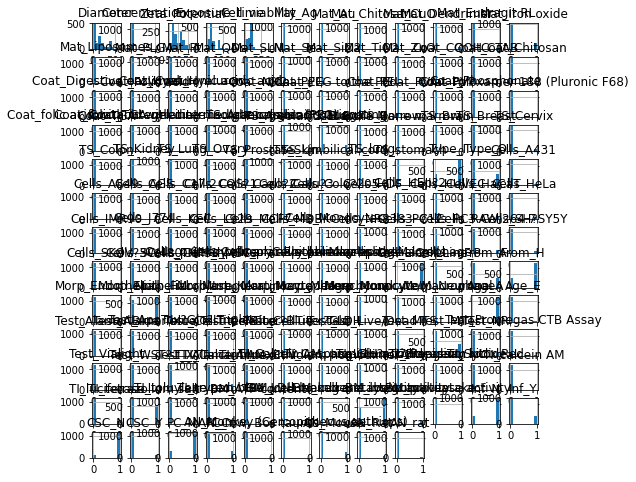

In [75]:
data.hist(figsize=(8,8))

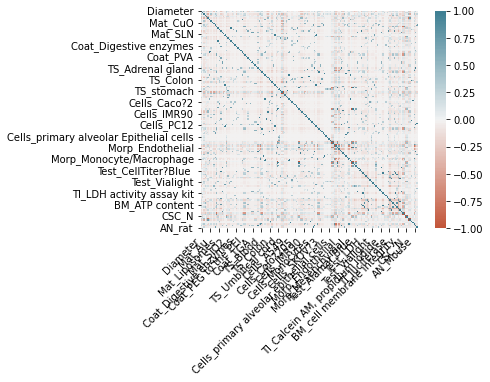

In [76]:
corr_matrix=data.corr()

ax = sns.heatmap(corr_matrix,vmin=-1, vmax=1, center=0,cmap=sns.diverging_palette(20, 220, n=200),square=True)
ax.set_xticklabels(ax.get_xticklabels(),rotation=45, horizontalalignment='right');

#sns.heatmap(corr_matrix,annot=True)

In [77]:
#normalize the data
mean = X.mean(axis = 0)
X -= mean
std = X.std(axis = 0)
X /= std

In [78]:
#Extract a holdout set at the very begining
X_train, X_holdout, y_train, y_holdout = train_test_split(X, Y, test_size=0.3, random_state = 17)

In [79]:
# example of grid searching key hyperparametres for logistic regression
from sklearn.datasets import make_blobs
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
# define dataset
# X, y = make_blobs(n_samples=1000, centers=2, n_features=100, cluster_std=20)
# define models and parameters
lg = LogisticRegression()
solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]
# define grid search
grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=lg, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X_train, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.853375 using {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.853375 (0.019310) with: {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.851094 (0.015010) with: {'C': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
0.851860 (0.017963) with: {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.850728 (0.019627) with: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}
0.851485 (0.019118) with: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.848836 (0.019428) with: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
0.852622 (0.017790) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
0.852622 (0.017790) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
0.849596 (0.019519) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
0.849221 (0.020466) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.849221 (0.020466) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}
0.849602 (0.024187) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'liblinear'}
0.842405 (0.022856) wit

In [80]:
from sklearn.metrics import accuracy_score
accuracy_score(y_holdout, grid_search.predict(X_holdout)) 

0.8364116094986808

In [81]:
#Import decision tree classification model and cross validation
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, cross_val_score, KFold, cross_val_predict, cross_validate
from sklearn.metrics import accuracy_score

In [82]:
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler

In [83]:
#Extract a holdout set at the very begining
X_train, X_holdout, y_train, y_holdout = train_test_split(X, Y, test_size=0.3, random_state = 17)

In [84]:
#CV to find the best parameters
from sklearn.tree import DecisionTreeClassifier
from sklearn import linear_model, tree, ensemble
from sklearn.model_selection import GridSearchCV, cross_val_score
tree = DecisionTreeClassifier(max_depth=5, random_state=17)
tree_params = {"max_depth": range(1, 11), "max_features": range(4, 19)}
tree_grid = GridSearchCV(tree, tree_params, cv=5, n_jobs=-1, verbose=True)
tree_grid.fit(X_train, y_train)

Fitting 5 folds for each of 150 candidates, totalling 750 fits


GridSearchCV(cv=5,
             estimator=DecisionTreeClassifier(max_depth=5, random_state=17),
             n_jobs=-1,
             param_grid={'max_depth': range(1, 11),
                         'max_features': range(4, 19)},
             verbose=True)

In [85]:
tree_grid.best_params_

{'max_depth': 9, 'max_features': 17}

In [86]:
tree_grid.best_score_

0.8900680534155111

In [87]:
accuracy_score(y_holdout, tree_grid.predict(X_holdout)) 

0.8522427440633246

In [88]:
dt = DecisionTreeClassifier(criterion='gini', max_depth = 2, \
                        min_samples_leaf = 0.10, random_state = 42)
 
scores = cross_val_score(dt, X_train, y_train, cv = 5)
print("\n" + ("*" * 100))
print("The cross-validation scores using cross_val_score method are \n{0}".format(scores))
print("*" * 100)
 
import numpy as np
print("\n" + ("*" * 100))
print("Mean of k-fold scores using cross_val_score method is {0}".format(np.mean(scores)))
print("*" * 100)
print("\n")


****************************************************************************************************
The cross-validation scores using cross_val_score method are 
[0.82485876 0.81920904 0.81818182 0.81818182 0.82954545]
****************************************************************************************************

****************************************************************************************************
Mean of k-fold scores using cross_val_score method is 0.8219953775038522
****************************************************************************************************




In [89]:
knn = KNeighborsClassifier(n_neighbors=10)

# for kNN, we need to scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_holdout_scaled = scaler.transform(X_holdout)
knn.fit(X_train_scaled, y_train)

KNeighborsClassifier(n_neighbors=10)

In [90]:
knn_pred = knn.predict(X_holdout_scaled)
accuracy_score(y_holdout, knn_pred)

0.8548812664907651

In [91]:
from sklearn.pipeline import Pipeline

knn_pipe = Pipeline([("scaler", StandardScaler()), ("knn", KNeighborsClassifier(n_jobs=-1))])

knn_params = {"knn__n_neighbors": range(1, 10)}

knn_grid = GridSearchCV(knn_pipe, knn_params, cv=5, n_jobs=-1, verbose=True)

knn_grid.fit(X_train, y_train)

knn_grid.best_params_, knn_grid.best_score_



Fitting 5 folds for each of 9 candidates, totalling 45 fits


({'knn__n_neighbors': 1}, 0.8798151001540833)

In [92]:
#predict on the test set (hold out values)

accuracy_score(y_holdout, knn_grid.predict(X_holdout))

0.8786279683377308

In [93]:
knn = KNeighborsClassifier(n_neighbors=10)
scores = cross_val_score(knn, X_train, y_train, cv = 5)
print("\n" + ("*" * 100))
print("The cross-validation scores using cross_val_score method are \n{0}".format(scores))
print("*" * 100)
 
import numpy as np
print("\n" + ("*" * 100))
print("Mean of k-fold scores using cross_val_score method is {0}".format(np.mean(scores)))
print("*" * 100)
print("\n")




****************************************************************************************************
The cross-validation scores using cross_val_score method are 
[0.84745763 0.85875706 0.82386364 0.85795455 0.84090909]
****************************************************************************************************

****************************************************************************************************
Mean of k-fold scores using cross_val_score method is 0.845788392398562
****************************************************************************************************




In [94]:
from sklearn.ensemble import RandomForestClassifier

forest = RandomForestClassifier(n_estimators=100, n_jobs=-1, random_state=17)
print(np.mean(cross_val_score(forest, X_train, y_train, cv=5))) 

0.8979712378017461


In [95]:
forest_params = {"max_depth": range(6, 12), "max_features": range(4, 19)}
forest_grid = GridSearchCV(forest, forest_params, cv=5, n_jobs=-1, verbose=True)
forest_grid.fit(X_train, y_train)
forest_grid.best_params_, forest_grid.best_score_

Fitting 5 folds for each of 90 candidates, totalling 450 fits


({'max_depth': 9, 'max_features': 18}, 0.9025038520801232)

In [96]:
accuracy_score(y_holdout, forest_grid.predict(X_holdout))

0.8865435356200527

In [98]:
forest = RandomForestClassifier(n_estimators=100, n_jobs=-1, random_state=17)
scores = cross_val_score(knn, X_train, y_train, cv = 5)
print("\n" + ("*" * 100))
print("The cross-validation scores using cross_val_score method are \n{0}".format(scores))
print("*" * 100)
 
import numpy as np
print("\n" + ("*" * 100))
print("Mean of k-fold scores using cross_val_score method is {0}".format(np.mean(scores)))
print("*" * 100)
print("\n")


****************************************************************************************************
The cross-validation scores using cross_val_score method are 
[0.84745763 0.85875706 0.82386364 0.85795455 0.84090909]
****************************************************************************************************

****************************************************************************************************
Mean of k-fold scores using cross_val_score method is 0.845788392398562
****************************************************************************************************




In [99]:
from sklearn.svm import SVC
svm = SVC(gamma='auto')
#svm=SVC()
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_holdout_scaled = scaler.transform(X_holdout)
svm.fit(X_train_scaled, y_train)

SVC(gamma='auto')

In [100]:
svm_pred = svm.predict(X_holdout_scaled)
accuracy_score(y_holdout, svm_pred)

0.8311345646437994

In [101]:
from sklearn.model_selection import StratifiedShuffleSplit
C_range = np.logspace(-2, 10, 13)
gamma_range = np.logspace(-9, 3, 13)
param_grid = dict(gamma=gamma_range, C=C_range)
cv = StratifiedShuffleSplit(n_splits=5, test_size=0.2, random_state=42)
svm_grid = GridSearchCV(SVC(), param_grid=param_grid, cv=5)
svm_grid.fit(X_train, y_train)
svm_grid.best_params_, svm_grid.best_score_

({'C': 1000000000.0, 'gamma': 1.0}, 0.8911466358500256)

In [102]:
accuracy_score(y_holdout, svm_grid.predict(X_holdout))

0.8733509234828496

In [103]:
svm = SVC(gamma='auto')
scores = cross_val_score(svm, X_train, y_train, cv = 5)
print("\n" + ("*" * 100))
print("The cross-validation scores using cross_val_score method are \n{0}".format(scores))
print("*" * 100)
 
import numpy as np
print("\n" + ("*" * 100))
print("Mean of k-fold scores using cross_val_score method is {0}".format(np.mean(scores)))
print("*" * 100)
print("\n")


****************************************************************************************************
The cross-validation scores using cross_val_score method are 
[0.85310734 0.85310734 0.84659091 0.86931818 0.83522727]
****************************************************************************************************

****************************************************************************************************
Mean of k-fold scores using cross_val_score method is 0.8514702105803801
****************************************************************************************************




In [104]:
from xgboost import XGBClassifier
xgb = XGBClassifier(n_estimators=1000, learning_rate=0.05)
print(np.mean(cross_val_score(xgb, X_train, y_train, cv=5)))

0.8786337955829481


In [105]:
from sklearn.model_selection import StratifiedShuffleSplit
learning_rate=0.04
xgb_params = {"n_estimators": range(500,1500,500)}
xgb_grid = GridSearchCV(xgb, xgb_params, cv=5, n_jobs=-1, verbose=True)
xgb_grid.fit(X_train, y_train)
xgb_grid.best_params_, xgb_grid.best_score_ 

Fitting 5 folds for each of 2 candidates, totalling 10 fits


({'n_estimators': 500}, 0.8786337955829481)

In [106]:
accuracy_score(y_holdout, xgb_grid.predict(X_holdout))

0.8469656992084432

In [107]:
xgb = XGBClassifier(n_estimators=500, learning_rate=0.05)
scores = cross_val_score(xgb, X_train, y_train, cv = 5)
print("\n" + ("*" * 100))
print("The cross-validation scores using cross_val_score method are \n{0}".format(scores))
print("*" * 100)
 
import numpy as np
print("\n" + ("*" * 100))
print("Mean of k-fold scores using cross_val_score method is {0}".format(np.mean(scores)))
print("*" * 100)
print("\n")

print("\n" + ("*" * 100))
print("Mean of k-fold scores using cross_val_score method is {0}".format(np.mean(scores)))
print("*" * 100)
print("\n")


****************************************************************************************************
The cross-validation scores using cross_val_score method are 
[0.90960452 0.89265537 0.86363636 0.85795455 0.86931818]
****************************************************************************************************

****************************************************************************************************
Mean of k-fold scores using cross_val_score method is 0.8786337955829481
****************************************************************************************************



****************************************************************************************************
Mean of k-fold scores using cross_val_score method is 0.8786337955829481
****************************************************************************************************




In [108]:
#SKlearn, you can use their hyper-parameter optimization tools. https://datascience.stackexchange.com/questions/36049/how-to-adjust-the-hyperparameters-of-mlp-classifier-to-get-more-perfect-performa
from sklearn.neural_network import MLPClassifier
# multi-layer perceptron (MLP)

#Define a hyper-parameter space to search. (All the values that you want to try out.)
parameter_space = {'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],}

from sklearn.model_selection import GridSearchCV
MLP = MLPClassifier()
MLP = GridSearchCV(MLP, parameter_space, n_jobs=-1, cv=5)
MLP.fit(X_train, y_train)


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


GridSearchCV(cv=5, estimator=MLPClassifier(), n_jobs=-1,
             param_grid={'activation': ['tanh', 'relu'],
                         'alpha': [0.0001, 0.05],
                         'hidden_layer_sizes': [(50, 50, 50), (50, 100, 50),
                                                (100,)],
                         'learning_rate': ['constant', 'adaptive'],
                         'solver': ['sgd', 'adam']})

In [109]:
# Best paramete set
print('Best parameters found:\n', MLP.best_params_)

# All results
means = MLP.cv_results_['mean_test_score']
stds = MLP.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, MLP.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (mean, std * 2, params))

Best parameters found:
 {'activation': 'relu', 'alpha': 0.05, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'solver': 'sgd'}
0.853 (+/-0.016) for {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 50, 50), 'learning_rate': 'constant', 'solver': 'sgd'}
0.847 (+/-0.051) for {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 50, 50), 'learning_rate': 'constant', 'solver': 'adam'}
0.838 (+/-0.019) for {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 50, 50), 'learning_rate': 'adaptive', 'solver': 'sgd'}
0.843 (+/-0.055) for {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 50, 50), 'learning_rate': 'adaptive', 'solver': 'adam'}
0.845 (+/-0.021) for {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 100, 50), 'learning_rate': 'constant', 'solver': 'sgd'}
0.842 (+/-0.027) for {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 100, 50), 'learning_rate': 'constant', 'solver': 'adam'}

In [110]:
accuracy_score(y_holdout, MLP.predict(X_holdout))


0.8364116094986808

In [111]:
y_true, y_pred = y_holdout , MLP.predict(X_holdout)

from sklearn.metrics import classification_report
print('Results on the test set:')
print(classification_report(y_true, y_pred))

Results on the test set:
              precision    recall  f1-score   support

         0.0       0.74      0.66      0.70       109
         1.0       0.87      0.91      0.89       270

    accuracy                           0.84       379
   macro avg       0.81      0.78      0.79       379
weighted avg       0.83      0.84      0.83       379



In [112]:
#best parameters 'activation': 'relu', 'alpha': 0.0001, 
#'hidden_layer_sizes': (50, 50, 50), 'learning_rate': 'adaptive', 'solver': 'sgd'
alpha=[1e-4,2e-4,3e-4,4e-4]
#alpha=0.0001
for count in alpha:
    #nn=MLPClassifier(solver='adam', alpha=count, hidden_layer_sizes=(150, 10), random_state=1)
    #nn=MLPClassifier(solver='lbfgs', alpha=1e-5, hidden_layer_sizes=(5, 2), random_state=1)
    nn=MLPClassifier(hidden_layer_sizes=(50,50,50), max_iter=300,activation = 'relu',solver='sgd',random_state=1)
    print(f'Learning rate: {count}')
    print(np.mean(cross_val_score(nn, X_train, y_train, cv=5)))
    print("The cross-validation scores using cross_val_score method are \n{0}".format(scores))
    print("Mean of MLP using cross_val_score method is {0}".format(np.mean(scores)))
    print("*" * 100)

Learning rate: 0.0001


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multi

0.8412621982537237
The cross-validation scores using cross_val_score method are 
[0.90960452 0.89265537 0.86363636 0.85795455 0.86931818]
Mean of MLP using cross_val_score method is 0.8786337955829481
****************************************************************************************************
Learning rate: 0.0002


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multi

0.8412621982537237
The cross-validation scores using cross_val_score method are 
[0.90960452 0.89265537 0.86363636 0.85795455 0.86931818]
Mean of MLP using cross_val_score method is 0.8786337955829481
****************************************************************************************************
Learning rate: 0.0003


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multi

0.8412621982537237
The cross-validation scores using cross_val_score method are 
[0.90960452 0.89265537 0.86363636 0.85795455 0.86931818]
Mean of MLP using cross_val_score method is 0.8786337955829481
****************************************************************************************************
Learning rate: 0.0004


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


0.8412621982537237
The cross-validation scores using cross_val_score method are 
[0.90960452 0.89265537 0.86363636 0.85795455 0.86931818]
Mean of MLP using cross_val_score method is 0.8786337955829481
****************************************************************************************************


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


In [113]:
# Libraries
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, precision_score, recall_score
from sklearn.ensemble import ExtraTreesClassifier
import warnings
warnings.filterwarnings('ignore')

In [114]:
accuracy_lst =[]

def model_assess(model, name='Default'):
    model.fit(X_train, y_train)
    prds = model.predict(X_holdout)
    model_acc = accuracy_score(y_holdout, prds)
    accuracy_lst.append(100*model_acc)
    print('---', name, '---', '\n',
    confusion_matrix(y_holdout, prds), '\n',
    'Accuracy:', (accuracy_score(y_holdout, prds)), '\n',
    'Classification Report:', (classification_report(y_holdout, prds)))
    fpr, tpr, thresholds = metrics.roc_curve(y_holdout, prds)
    roc_auc = metrics.auc(fpr, tpr)
    display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,estimator_name='example estimator')
    display.plot()
    plt.show()

--- Logistic Regression --- 
 [[ 78  31]
 [ 31 239]] 
 Accuracy: 0.8364116094986808 
 Classification Report:               precision    recall  f1-score   support

         0.0       0.72      0.72      0.72       109
         1.0       0.89      0.89      0.89       270

    accuracy                           0.84       379
   macro avg       0.80      0.80      0.80       379
weighted avg       0.84      0.84      0.84       379



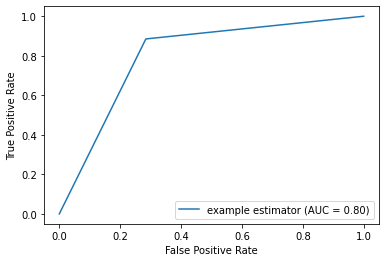

Fitting 5 folds for each of 150 candidates, totalling 750 fits
--- Decission Trees --- 
 [[ 74  35]
 [ 21 249]] 
 Accuracy: 0.8522427440633246 
 Classification Report:               precision    recall  f1-score   support

         0.0       0.78      0.68      0.73       109
         1.0       0.88      0.92      0.90       270

    accuracy                           0.85       379
   macro avg       0.83      0.80      0.81       379
weighted avg       0.85      0.85      0.85       379



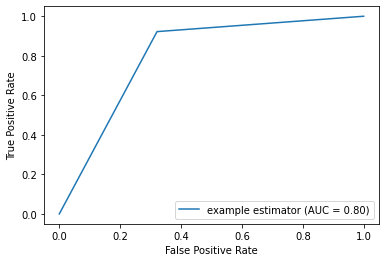

Fitting 5 folds for each of 90 candidates, totalling 450 fits
--- Random Forest --- 
 [[ 81  28]
 [ 15 255]] 
 Accuracy: 0.8865435356200527 
 Classification Report:               precision    recall  f1-score   support

         0.0       0.84      0.74      0.79       109
         1.0       0.90      0.94      0.92       270

    accuracy                           0.89       379
   macro avg       0.87      0.84      0.86       379
weighted avg       0.88      0.89      0.88       379



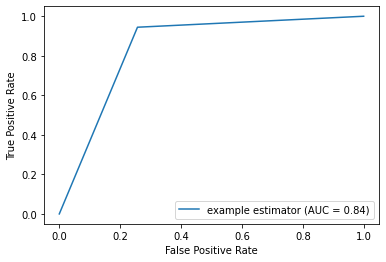

--- SVM --- 
 [[ 72  37]
 [ 27 243]] 
 Accuracy: 0.8311345646437994 
 Classification Report:               precision    recall  f1-score   support

         0.0       0.73      0.66      0.69       109
         1.0       0.87      0.90      0.88       270

    accuracy                           0.83       379
   macro avg       0.80      0.78      0.79       379
weighted avg       0.83      0.83      0.83       379



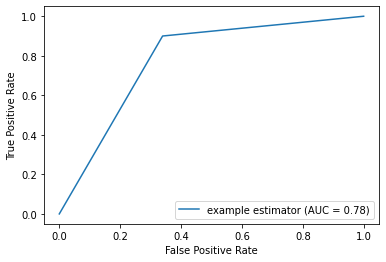

Fitting 5 folds for each of 9 candidates, totalling 45 fits
--- KNN --- 
 [[ 85  24]
 [ 22 248]] 
 Accuracy: 0.8786279683377308 
 Classification Report:               precision    recall  f1-score   support

         0.0       0.79      0.78      0.79       109
         1.0       0.91      0.92      0.92       270

    accuracy                           0.88       379
   macro avg       0.85      0.85      0.85       379
weighted avg       0.88      0.88      0.88       379



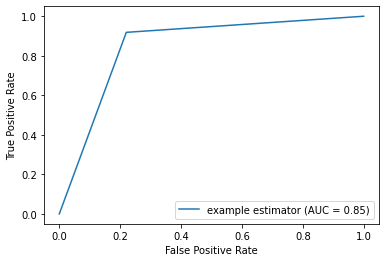

Fitting 5 folds for each of 2 candidates, totalling 10 fits
--- XGBoost --- 
 [[ 66  43]
 [ 15 255]] 
 Accuracy: 0.8469656992084432 
 Classification Report:               precision    recall  f1-score   support

         0.0       0.81      0.61      0.69       109
         1.0       0.86      0.94      0.90       270

    accuracy                           0.85       379
   macro avg       0.84      0.77      0.80       379
weighted avg       0.84      0.85      0.84       379



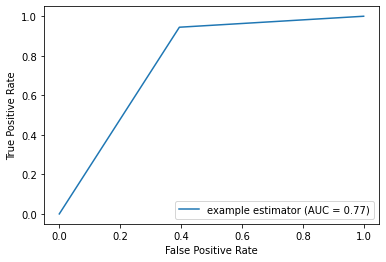

KeyboardInterrupt: ignored

In [115]:
# Logistic Regression
#lg = LogisticRegression(penalty='l2', solver='newton-cg',C=1.0)
model_assess(grid_search, 'Logistic Regression')


# Decision Tree
#tree = DecisionTreeClassifier(max_depth=10, max_features=16)
model_assess(tree_grid, 'Decission Trees')

# Random Forest
#rforest = RandomForestClassifier(n_estimators=100, max_depth=10, n_jobs=-1, random_state=17)
model_assess(forest_grid, 'Random Forest')

# SVM
svm_grid = SVC(gamma='auto',probability=True)
model_assess(svm_grid, 'SVM')

# KNN
#knn = KNeighborsClassifier(n_neighbors=3)
model_assess(knn_grid, name='KNN')

# XGBOOST
#xgb = XGBClassifier(n_estimators=500)
model_assess( xgb_grid, 'XGBoost')

#best parameters 'activation': 'relu', 'alpha': 0.0001, 
#'hidden_layer_sizes': (50, 50, 50), 'learning_rate': 'adaptive', 'solver': 'sgd

# Neural Network
#nn = MLPClassifier(activation='relu',solver='sgd', alpha=1e-4, hidden_layer_sizes=(50,50,50), random_state=1,learning_rate='adaptive')
model_assess(MLP, 'Neural Nets')

In [ ]:
# predict probabilities
pred_prob1 = grid_search.predict_proba(X_holdout)
pred_prob2 = tree_grid.predict_proba(X_holdout)
pred_prob3 = forest_grid.predict_proba(X_holdout)
pred_prob4 = svm_grid.predict_proba(X_holdout)
pred_prob5 = knn_grid.predict_proba(X_holdout_scaled)
pred_prob6 = xgb_grid.predict_proba(X_holdout)
pred_prob7 = MLP.predict_proba(X_holdout)

In [ ]:
from sklearn.metrics import roc_curve

# roc curve for models
fpr1, tpr1, thresh1 = roc_curve(y_holdout, pred_prob1[:,1], pos_label=1)
fpr2, tpr2, thresh2 = roc_curve(y_holdout, pred_prob2[:,1], pos_label=1)
fpr3, tpr3, thresh3 = roc_curve(y_holdout, pred_prob3[:,1], pos_label=1)
fpr4, tpr4, thresh4 = roc_curve(y_holdout, pred_prob4[:,1], pos_label=1)
fpr5, tpr5, thresh5 = roc_curve(y_holdout, pred_prob5[:,1], pos_label=1)
fpr6, tpr6, thresh6 = roc_curve(y_holdout, pred_prob6[:,1], pos_label=1)
fpr7, tpr7, thresh7 = roc_curve(y_holdout, pred_prob7[:,1], pos_label=1)

# roc curve for tpr = fpr 
random_probs = [0 for i in range(len(y_holdout))]
p_fpr, p_tpr, _ = roc_curve(y_holdout, random_probs, pos_label=1)

In [ ]:
from sklearn.metrics import roc_auc_score

# auc scores
auc_score1 = roc_auc_score(y_holdout, pred_prob1[:,1])
auc_score2 = roc_auc_score(y_holdout, pred_prob2[:,1])
auc_score3 = roc_auc_score(y_holdout, pred_prob3[:,1])
auc_score4 = roc_auc_score(y_holdout, pred_prob4[:,1])
auc_score5 = roc_auc_score(y_holdout, pred_prob5[:,1])
auc_score6 = roc_auc_score(y_holdout, pred_prob6[:,1])
auc_score7 = roc_auc_score(y_holdout, pred_prob7[:,1])

#print(auc_score1, auc_score2, auc_score3, auc_score5, auc_score6, auc_score7)
print(auc_score2, auc_score3, auc_score4, auc_score5, auc_score6, auc_score7)

In [ ]:
# matplotlib
import matplotlib.pyplot as plt
plt.style.use('seaborn')

# plot roc curves
plt.plot(fpr1, tpr1, linestyle='--',color='orange', label='Logistic Regression')
plt.plot(fpr2, tpr2, linestyle='--',color='green', label='Decision tree')
plt.plot(fpr3, tpr3, linestyle='--',color='red', label='Random Forest')
plt.plot(fpr4, tpr4, linestyle='--',color='orange', label='SVM')
plt.plot(fpr5, tpr5, linestyle='--',color='black', label='KNN')
plt.plot(fpr6, tpr6, linestyle='--',color='red', label='XGBoost')
plt.plot(fpr7, tpr7, linestyle='--',color='pink', label='Neural Networks')
plt.plot(p_fpr, p_tpr, linestyle='--', color='blue')
# title
plt.title('ROC curve')
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.savefig('ROC',dpi=300)
plt.show();

In [ ]:
!pip install shap
import matplotlib
import matplotlib.pyplot as plt
import shap



In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

In [ ]:
def model_assess(model, name='Default'):
    model.fit(X_train, y_train)

In [ ]:
#Decision Tree
tree = DecisionTreeClassifier(max_depth=10, max_features=16)
model_assess(tree, 'Decission Trees')

# Random Forest
rforest = RandomForestClassifier(n_estimators=100, max_depth=10, n_jobs=-1, random_state=17)
model_assess(rforest, 'Random Forest')


# XGBOOST
xgb = XGBClassifier(n_estimators=500)
model_assess( xgb, 'XGBoost')


In [ ]:
explainer = shap.TreeExplainer(tree)  #decision tree
shap_values = explainer.shap_values(X)
feature_names=list(data.columns.values.tolist())
ax1 = shap.summary_plot(shap_values, X, plot_type="bar",feature_names=list(data.columns.values.tolist()))
ax2 = shap.summary_plot(shap_values, X, feature_names=list(data.columns.values.tolist()))
#ax3= shap.dependence_plot(0, shap_values, X)

In [ ]:
explainer = shap.TreeExplainer(rforest)  #random forest
shap_values = explainer.shap_values(X)
feature_names=list(data.columns.values.tolist())
ax1 = shap.summary_plot(shap_values, X, plot_type="bar",feature_names=list(data.columns.values.tolist()))
ax2 = shap.summary_plot(shap_values, X, feature_names=list(data.columns.values.tolist()))
#ax3= shap.dependence_plot(0, shap_values, X)

In [ ]:
explainer = shap.TreeExplainer(xgb)  #XGBoost model
shap_values = explainer.shap_values(X)
feature_names=list(data.columns.values.tolist())
ax1 = shap.summary_plot(shap_values, X, plot_type="bar",feature_names=list(data.columns.values.tolist()))
ax2 = shap.summary_plot(shap_values, X, feature_names=list(data.columns.values.tolist()))
ax3= shap.dependence_plot(0, shap_values, X)


In [ ]:
#base line accuracy = ratio of larger set/total data points
#total % of high viability cells from reduced dataset(1261)

base_line_acc = (Y.sum()/len(Y))

base_line_acc